In [1]:
import os
import cv2
import numpy as np
import pandas as pd
import nibabel as nib
from skimage import transform
import matplotlib.pyplot as plt

In [2]:
def load_mri(filepath):
    """Loads MRI nii file returns a 2D float 32 array of range [0, 1]"""
    mri = nib.load(filepath).get_fdata()
    temp = mri - np.min(mri)
    return (temp / (1 if np.max(temp) == 0 else np.max(temp))).astype(np.float32)

In [3]:
def get_leaf_dirs(dir):
    '''
    @param dir: The parent directory to recursively search
    returns: A list of paths to all leaf directories(full paths)
    '''
    return [dirpath for dirpath, dirnames, filenames in os.walk(dir) if not dirnames]

In [19]:
slice_dir = "/data/ur/bukowy/LaViolette_Data/Prostates/1200/15"
mri_filenames = ["mri_slice_double.nii",
              "mri_slice_double_T2.nii",
              "mri_slice_double_T2_norm.nii",
              "mri_slice_double_T2_bladdernorm.nii",
              "mri_slice_double_T2_musclenorm.nii"]
plt.imshow(plt.imread(os.path.join(slice_dir, "small_recon_8_pgt_sharp.tiff")))

FileNotFoundError: [Errno 2] No such file or directory: '/data/ur/bukowy/LaViolette_Data/Prostates/1200/15/small_recon_8_pgt_sharp.tiff'

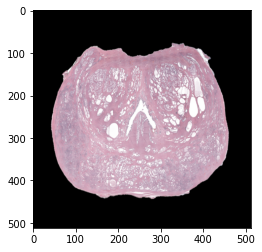

In [6]:
parent_dir = "/data/ur/bukowy/LaViolette_Data/Prostates/"
all_slides = get_leaf_dirs(parent_dir)

In [318]:
len(all_slides)

400

In [23]:
def apply_scale(points, scale):
    points = points.copy()
    center_vert = 255#np.mean(points[:, 0])
    dists_from_center = points[:, 0] -  center_vert
    points[:, 0] = points[:, 0] + (dists_from_center * scale)
    points = points.astype(int)
    return points

In [173]:
def get_edge_points(points, tolerance=15):
    origin = np.mean(points, axis=0)
    relative_coords = points - origin
    magnitudes = np.sqrt(np.sum(relative_coords * relative_coords, axis=-1))
    angles = (np.arctan2(relative_coords[:, 0], relative_coords[:, 1]) + 3.14159) * (180/3.14159)
    is_edge_point = []
    for i in range(len(points)):
        current_angle = angles[i]
        comparisons = (angles < ((current_angle + tolerance) % 360)) & (angles > ((current_angle - tolerance) % 360))
        if np.sum(comparisons) == 0:
            is_edge_point.append(False)
        else:
            is_edge_point.append(magnitudes[i] >= np.max(magnitudes[comparisons]))
    is_edge_point = np.array(is_edge_point)
    return is_edge_point

In [174]:
i = 40

skipping slide 0
skipping slide 1
skipping slide 2
skipping slide 3


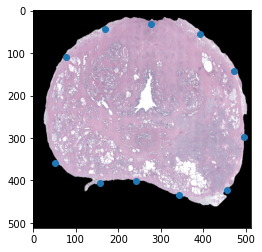

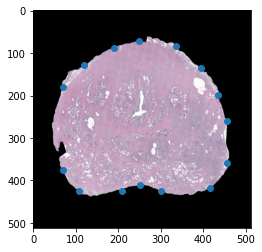

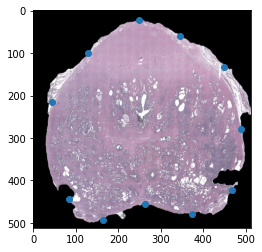

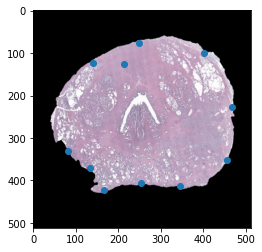

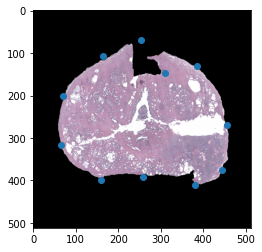

...

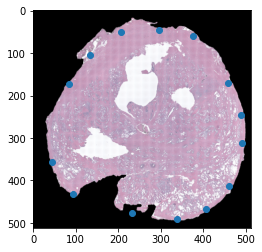

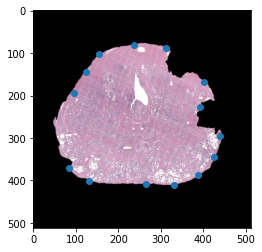

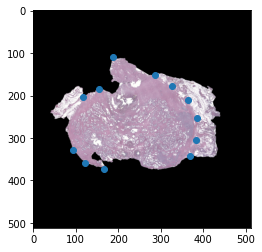

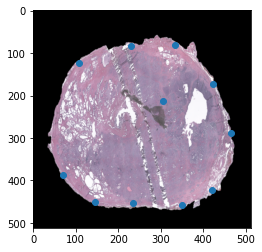

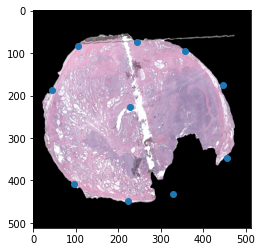

skipping slide 22


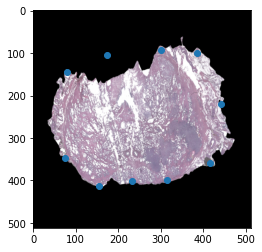

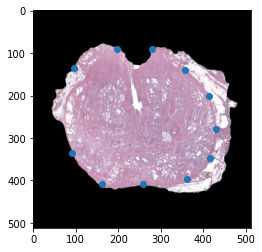

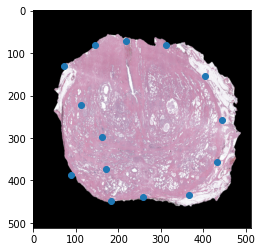

skipping slide 26
skipping slide 27
skipping slide 28


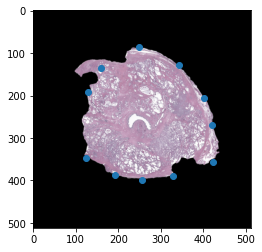

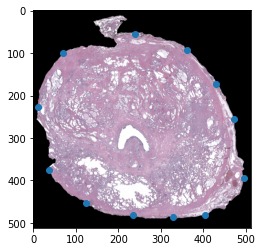

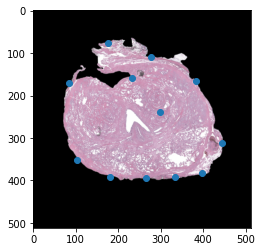

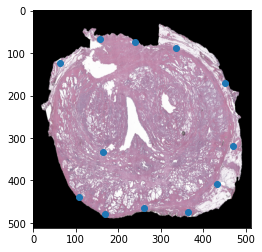

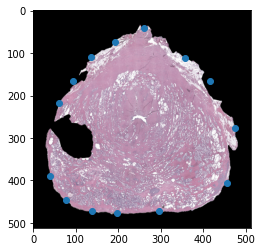

skipping slide 34
skipping slide 35
skipping slide 36


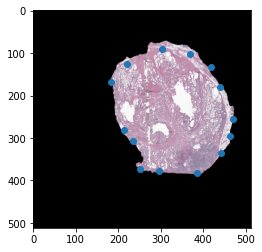

skipping slide 38


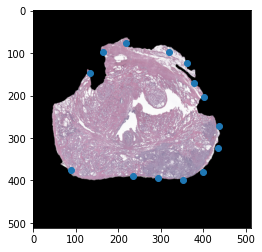

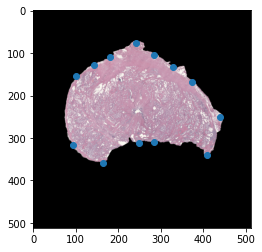

skipping slide 41


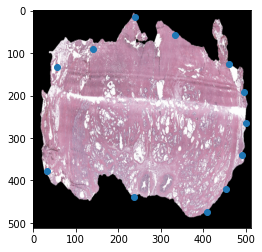

skipping slide 43
skipping slide 44
skipping slide 45


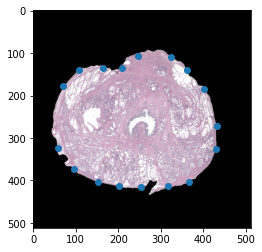

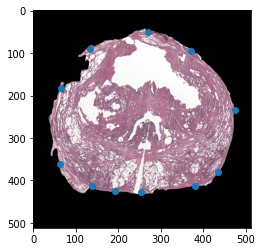

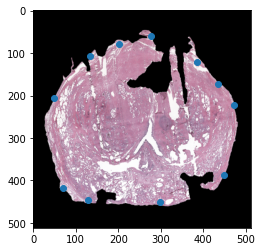

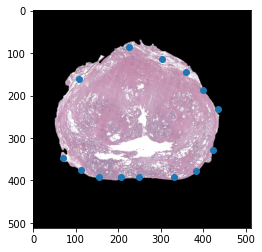

skipping slide 50


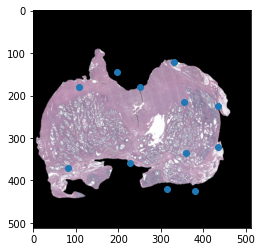

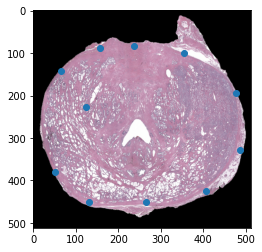

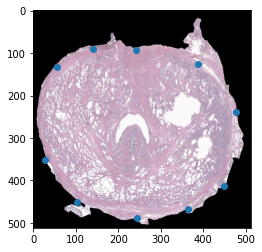

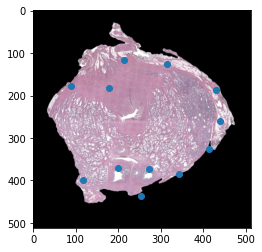

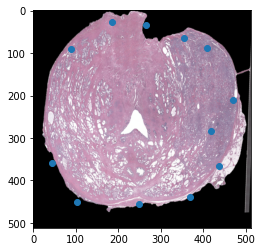

skipping slide 56
skipping slide 57
skipping slide 58
skipping slide 59
skipping slide 60
skipping slide 61
skipping slide 62
skipping slide 63
skipping slide 64
skipping slide 65
skipping slide 66
skipping slide 67


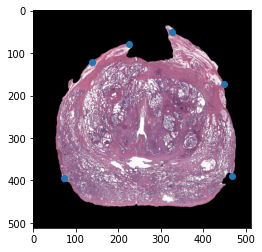

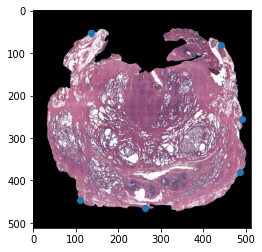

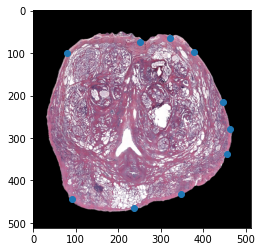

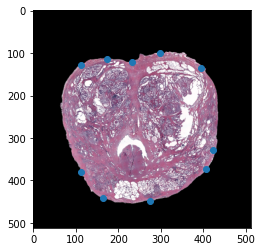

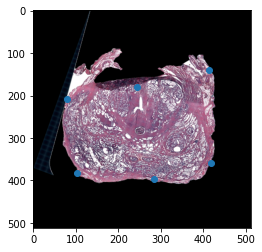

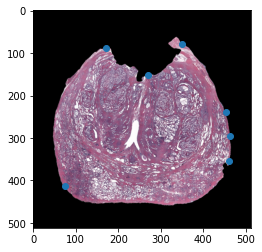

skipping slide 74


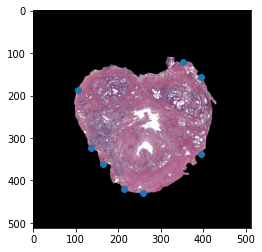

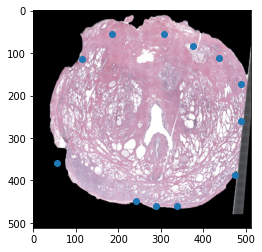

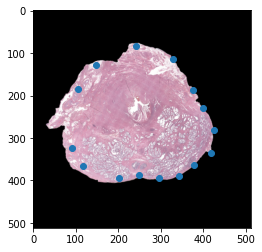

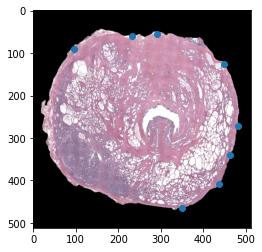

skipping slide 79


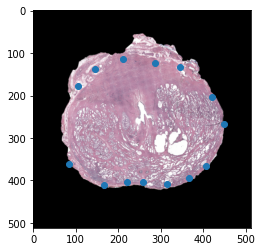

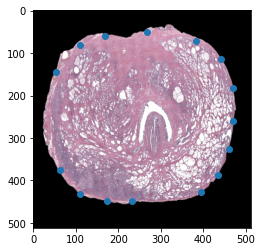

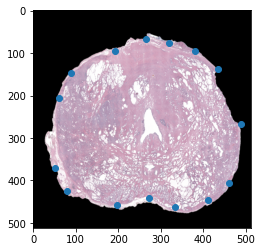

skipping slide 83


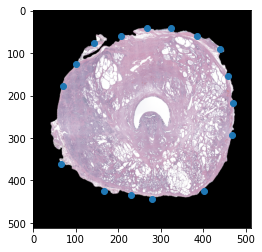

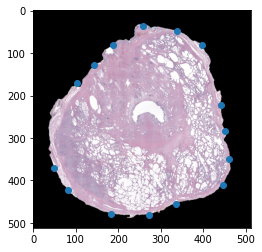

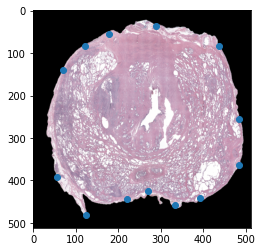

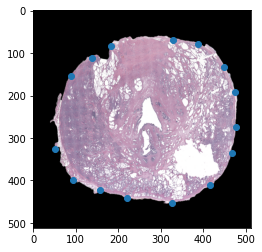

skipping slide 88
skipping slide 89
skipping slide 90
skipping slide 91
skipping slide 92
skipping slide 93
skipping slide 94


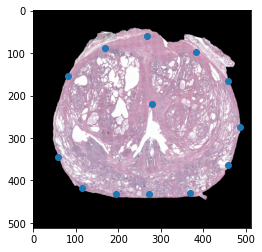

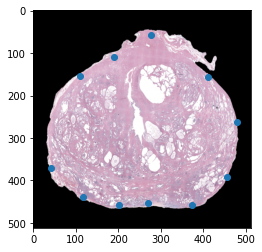

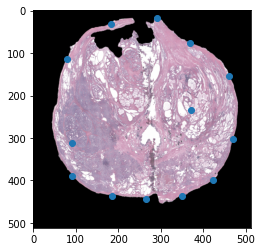

skipping slide 98


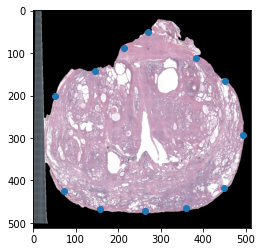

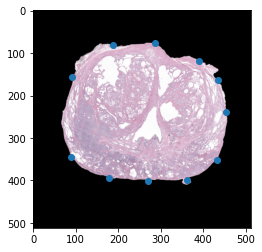

skipping slide 101
skipping slide 102
skipping slide 103
skipping slide 104
skipping slide 105


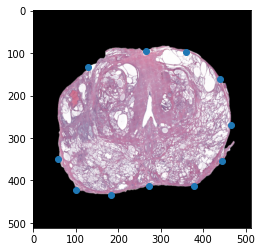

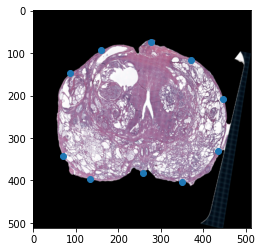

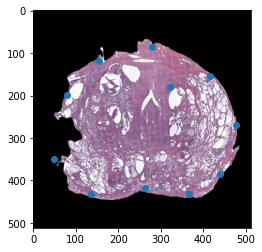

skipping slide 109
skipping slide 110
skipping slide 111


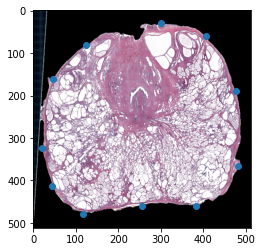

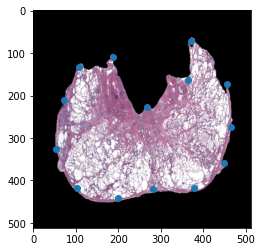

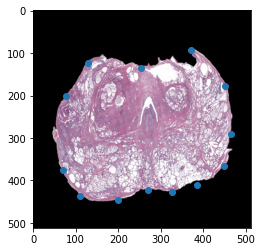

skipping slide 115
skipping slide 116
skipping slide 117
skipping slide 118
skipping slide 119


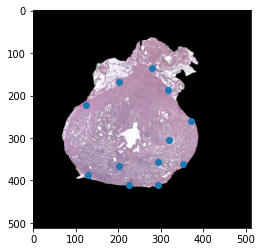

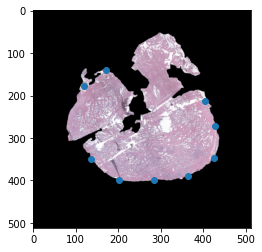

skipping slide 122
skipping slide 123


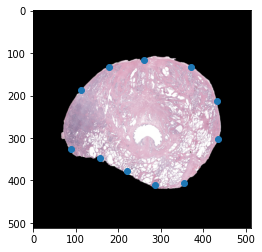

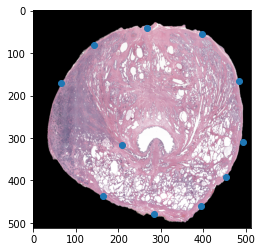

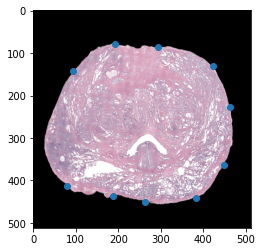

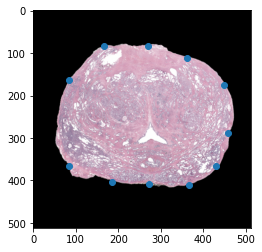

skipping slide 128


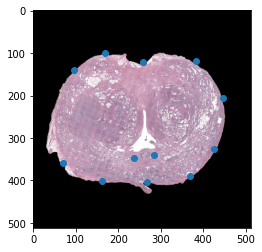

skipping slide 130


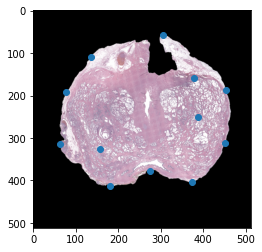

skipping slide 132
skipping slide 133


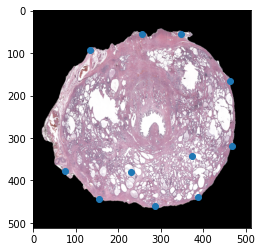

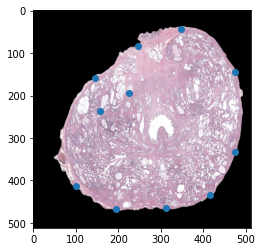

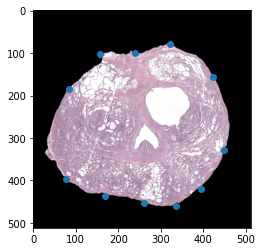

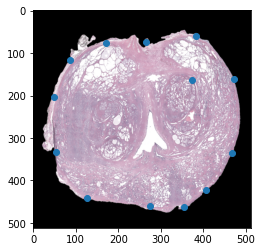

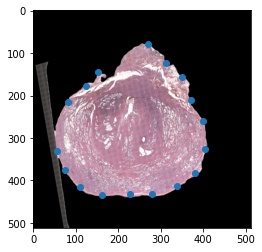

skipping slide 139
skipping slide 140
skipping slide 141
skipping slide 142


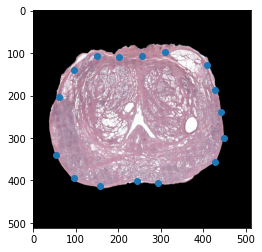

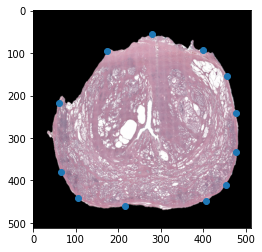

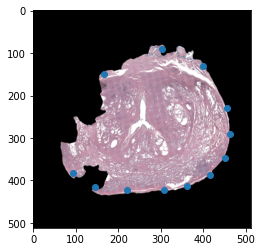

skipping slide 146
skipping slide 147
skipping slide 148
skipping slide 149


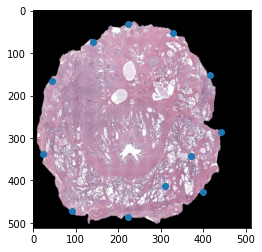

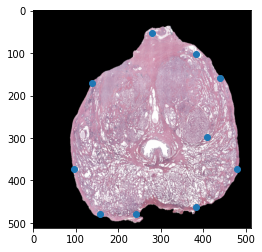

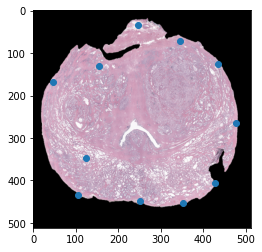

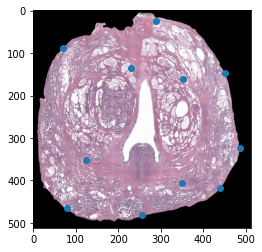

skipping slide 154
skipping slide 155


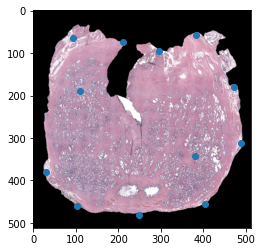

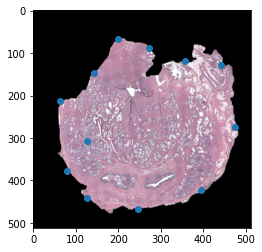

skipping slide 158
skipping slide 159
skipping slide 160
skipping slide 161
skipping slide 162
skipping slide 163
skipping slide 164
skipping slide 165
skipping slide 166


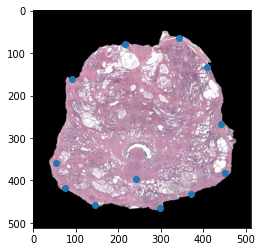

skipping slide 168


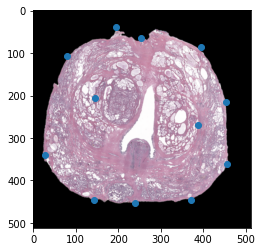

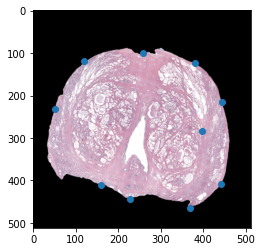

skipping slide 171
skipping slide 172
skipping slide 173


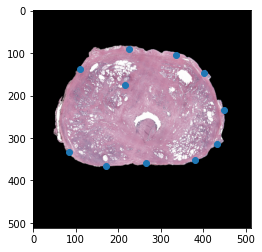

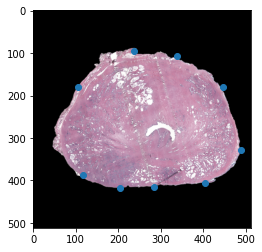

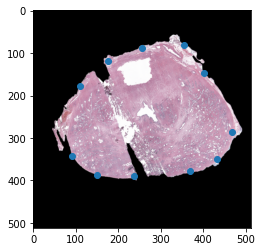

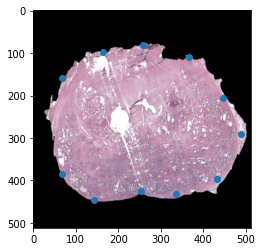

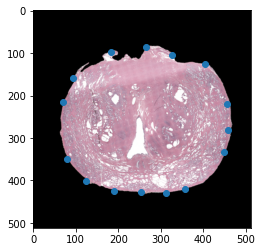

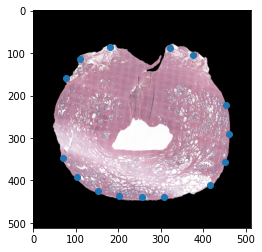

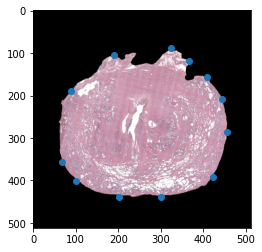

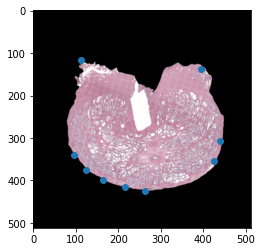

skipping slide 182
skipping slide 183


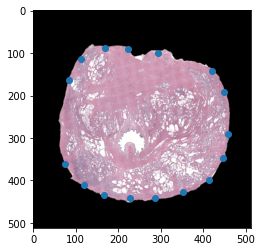

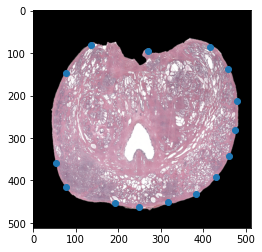

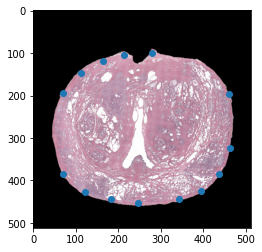

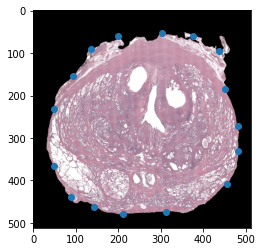

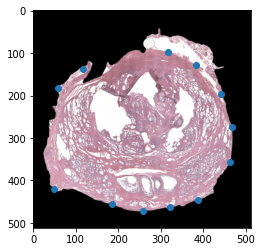

skipping slide 189
skipping slide 190
skipping slide 191


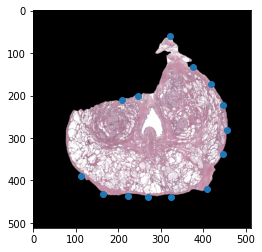

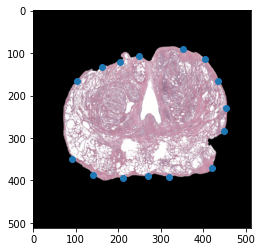

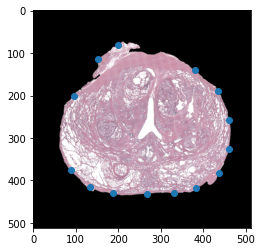

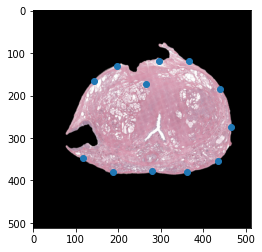

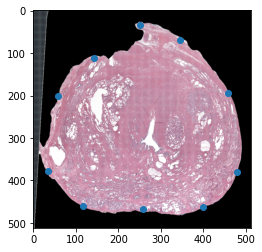

skipping slide 197
skipping slide 198
skipping slide 199
skipping slide 200


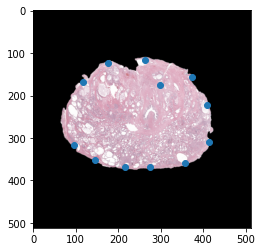

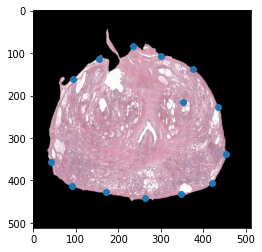

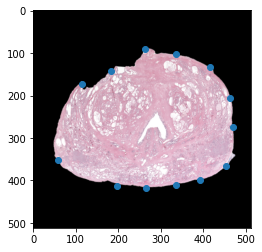

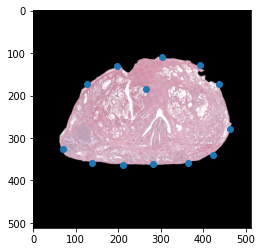

skipping slide 205
skipping slide 206
skipping slide 207
skipping slide 208
skipping slide 209
skipping slide 210
skipping slide 211
skipping slide 212
skipping slide 213
skipping slide 214


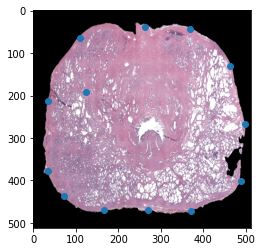

skipping slide 216
skipping slide 217


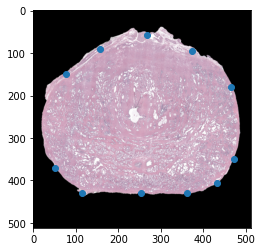

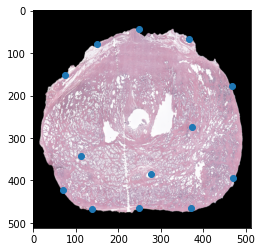

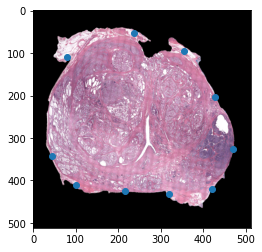

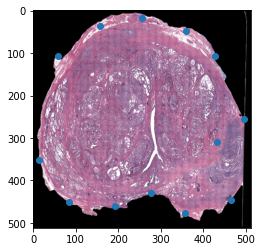

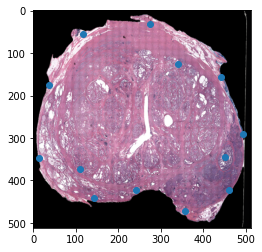

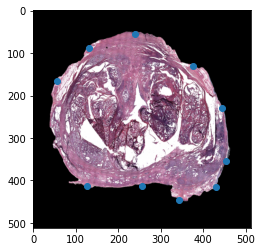

skipping slide 224
skipping slide 225
skipping slide 226
skipping slide 227


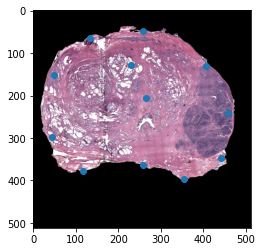

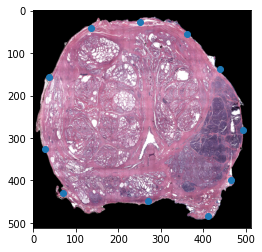

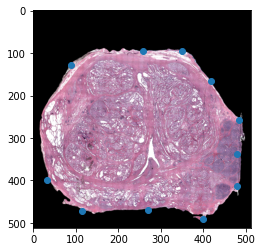

skipping slide 231
skipping slide 232
skipping slide 233


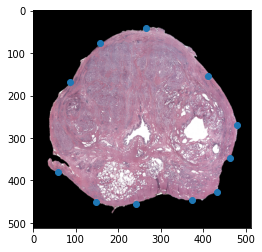

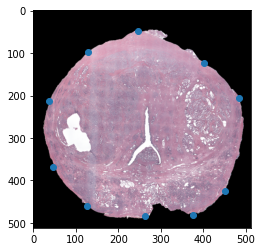

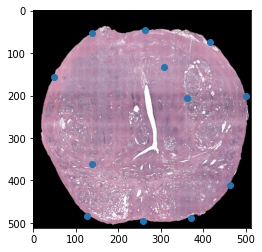

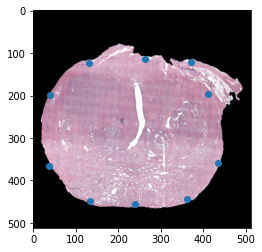

skipping slide 238
skipping slide 239


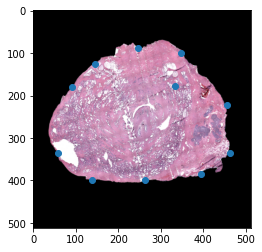

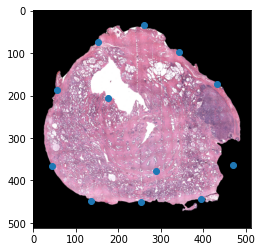

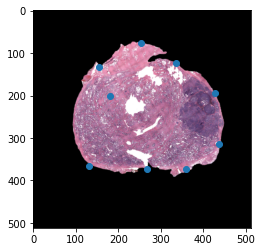

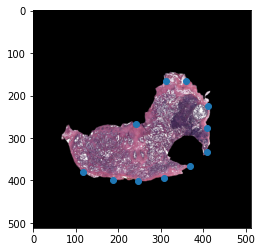

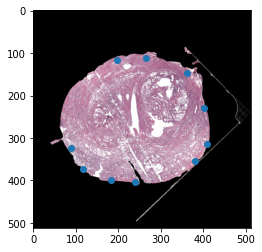

skipping slide 245
skipping slide 246
skipping slide 247
skipping slide 248
skipping slide 249


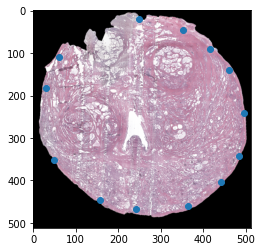

skipping slide 251


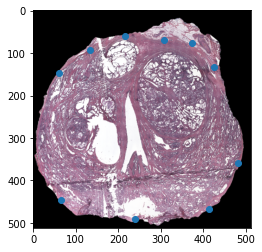

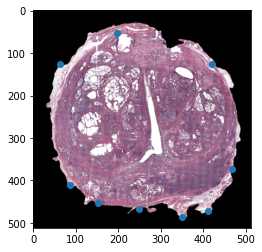

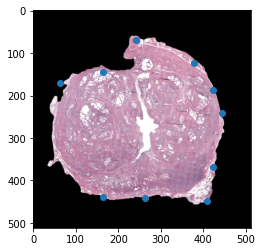

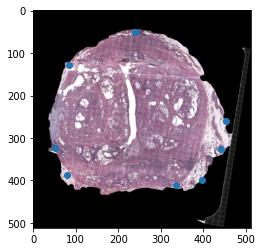

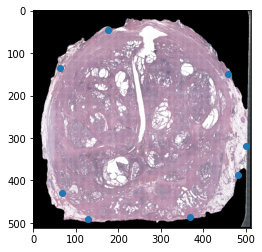

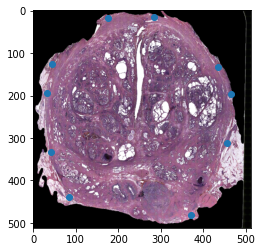

skipping slide 258
skipping slide 259


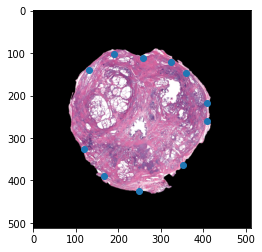

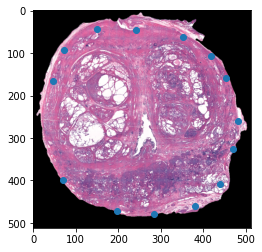

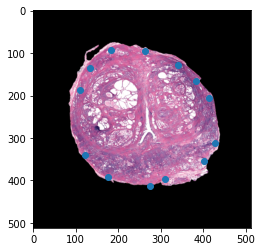

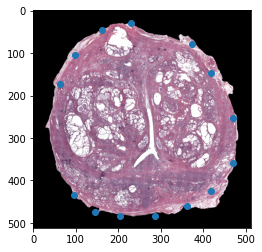

skipping slide 264
skipping slide 265
skipping slide 266


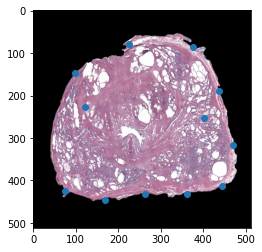

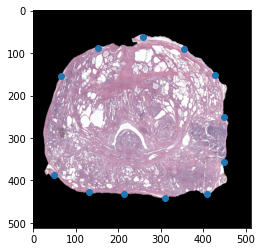

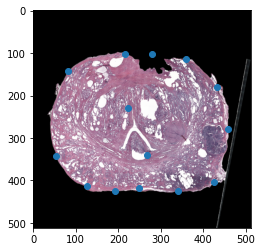

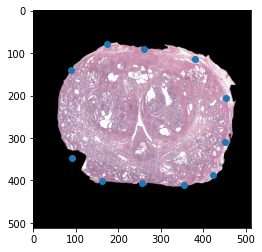

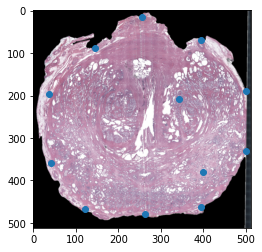

skipping slide 272
skipping slide 273
skipping slide 274
skipping slide 275
skipping slide 276
skipping slide 277


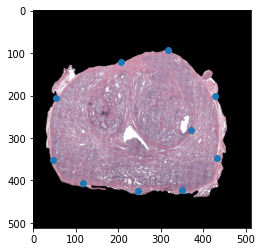

skipping slide 279
skipping slide 280


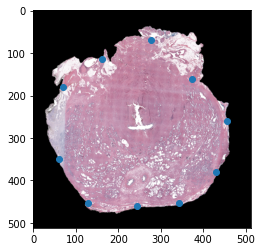

skipping slide 282
skipping slide 283
skipping slide 284
skipping slide 285


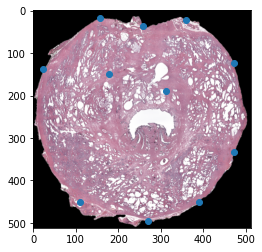

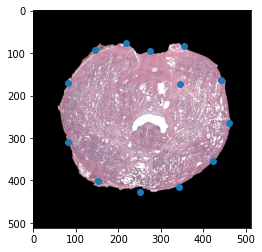

skipping slide 288
skipping slide 289


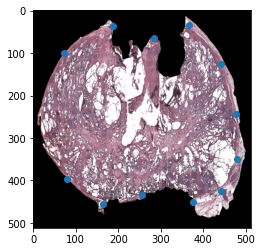

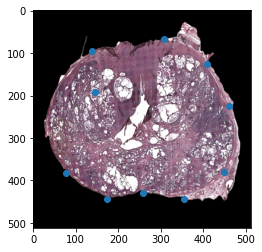

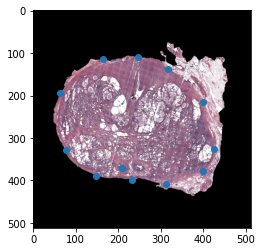

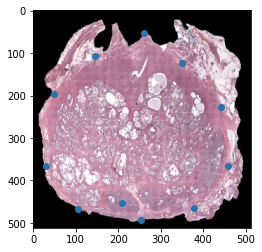

skipping slide 294
skipping slide 295
skipping slide 296
skipping slide 297


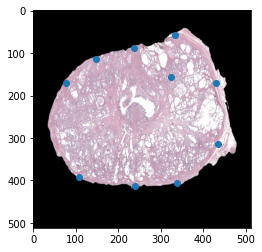

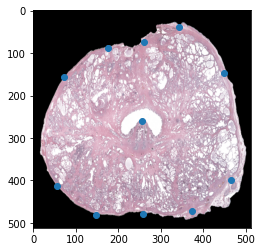

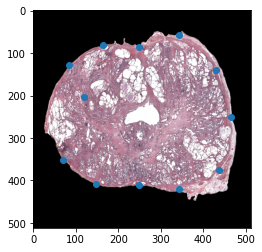

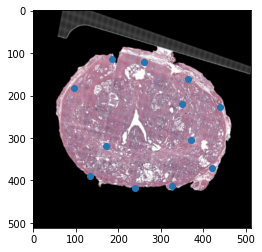

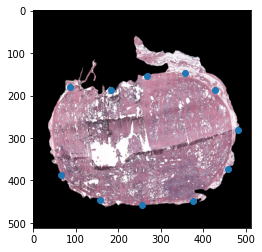

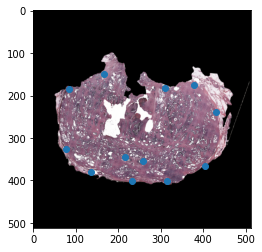

skipping slide 304
skipping slide 305


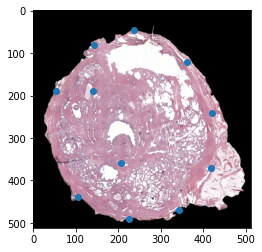

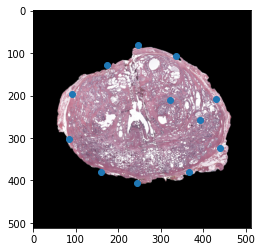

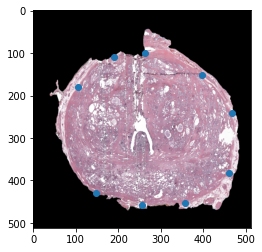

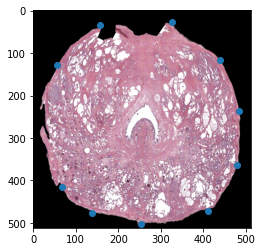

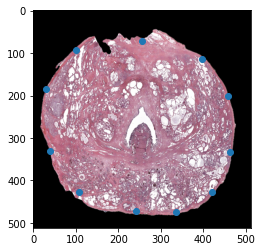

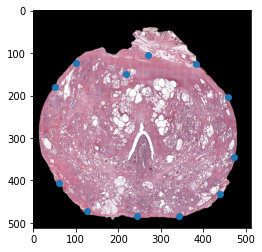

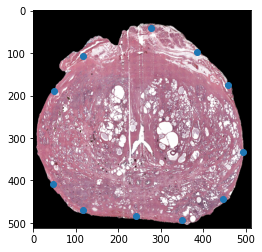

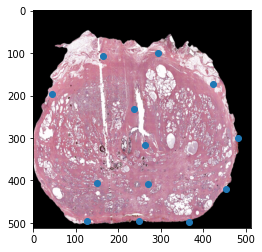

skipping slide 314


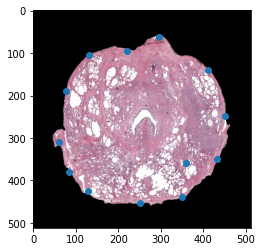

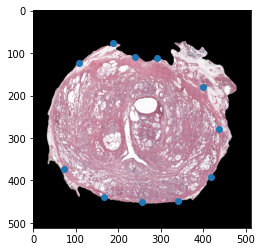

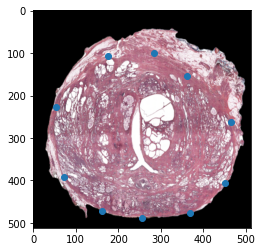

skipping slide 318
skipping slide 319
skipping slide 320


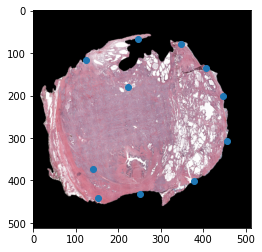

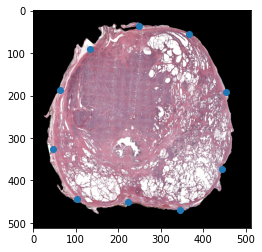

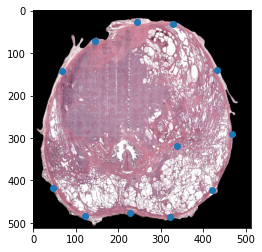

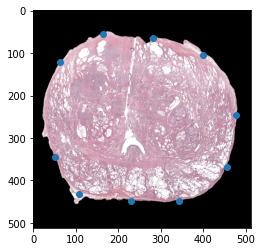

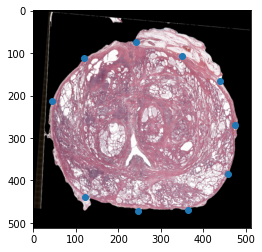

...

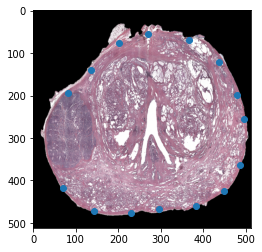

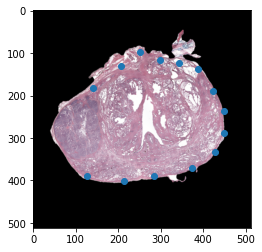

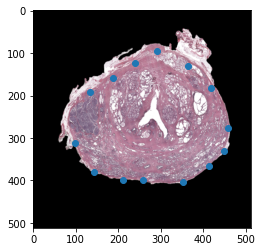

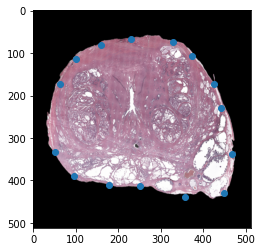

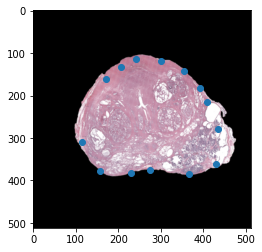

skipping slide 334
skipping slide 335


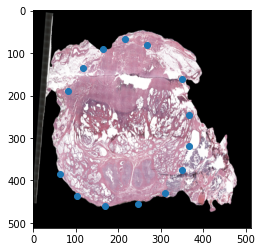

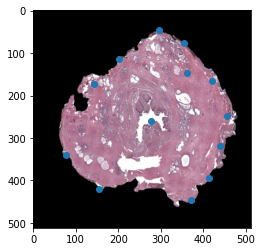

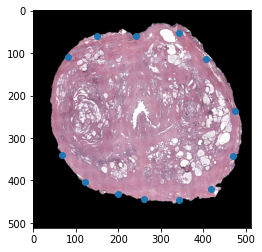

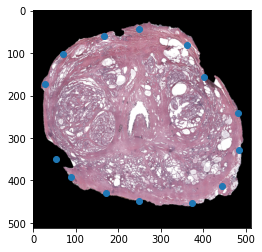

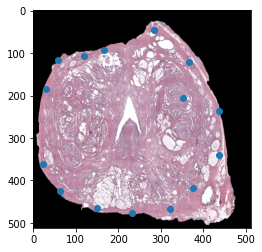

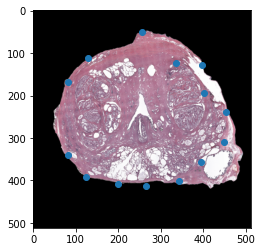

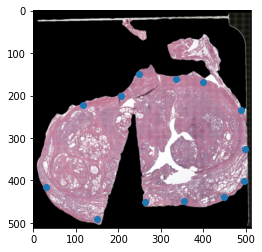

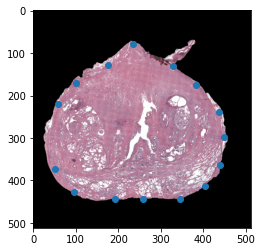

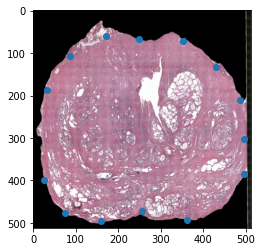

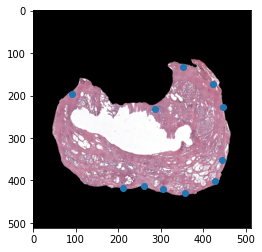

skipping slide 346


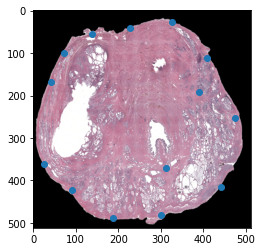

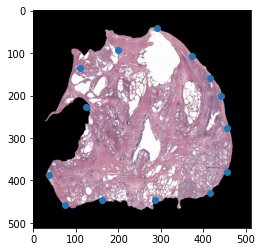

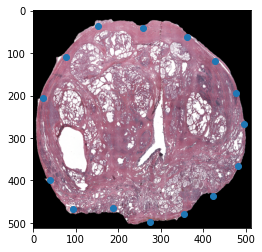

skipping slide 350
skipping slide 351


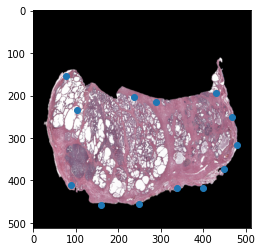

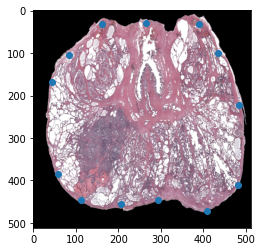

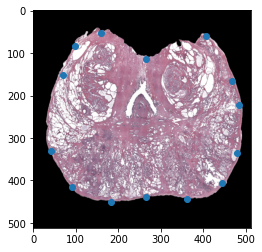

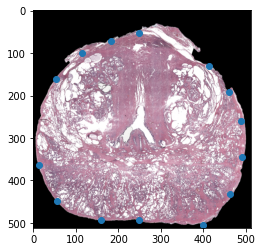

skipping slide 356
skipping slide 357
skipping slide 358
skipping slide 359


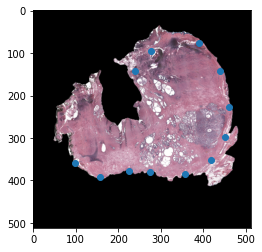

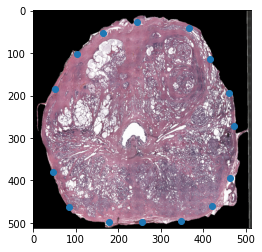

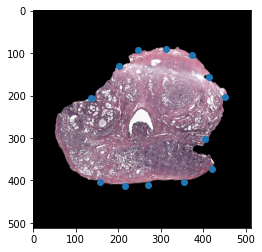

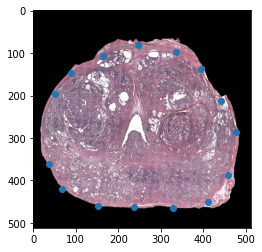

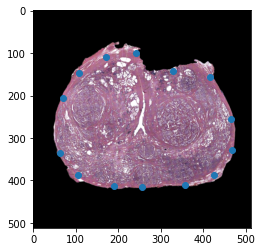

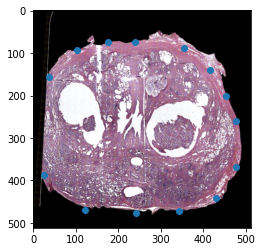

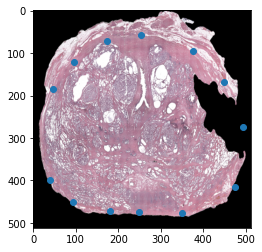

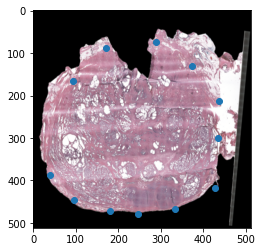

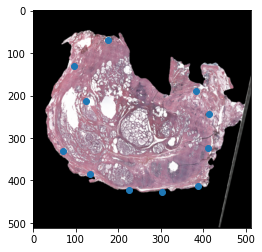

skipping slide 369
skipping slide 370


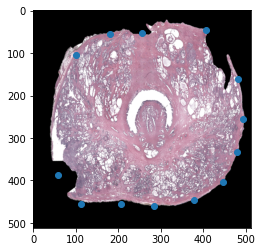

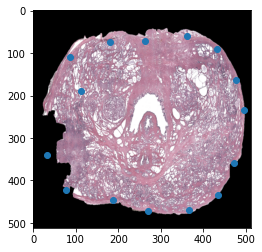

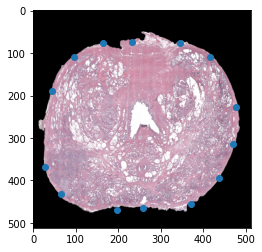

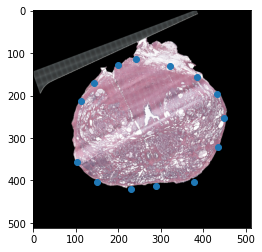

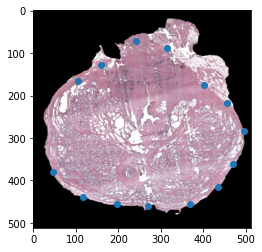

skipping slide 376
skipping slide 377


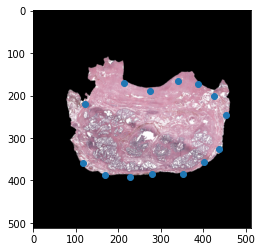

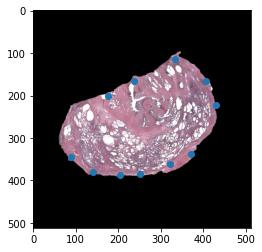

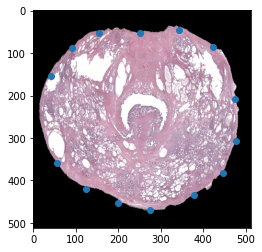

skipping slide 381


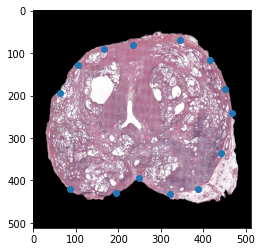

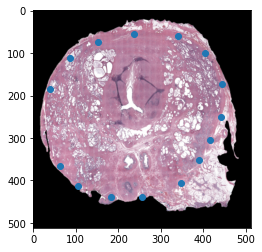

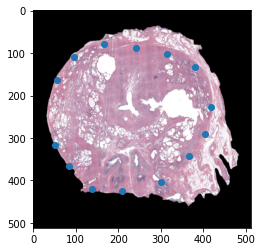

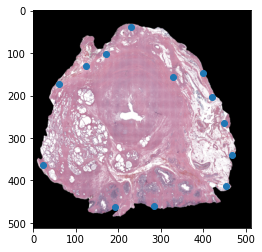

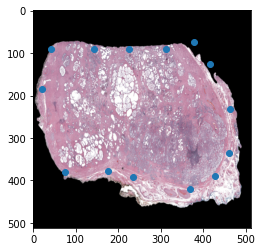

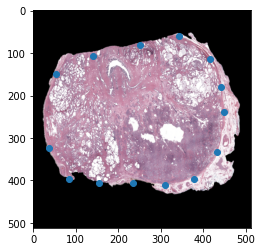

skipping slide 388


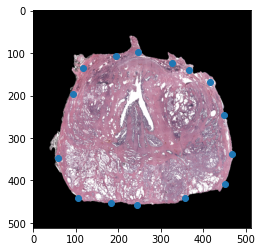

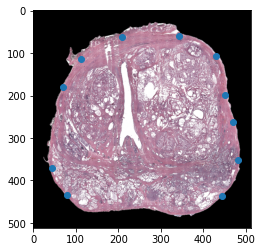

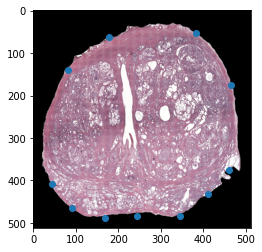

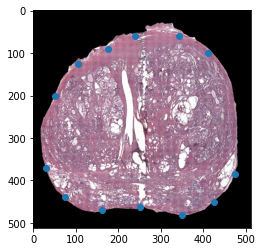

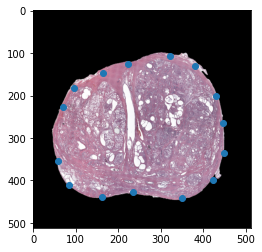

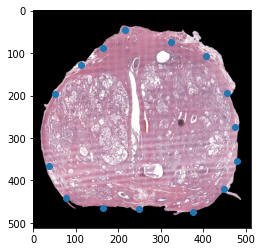

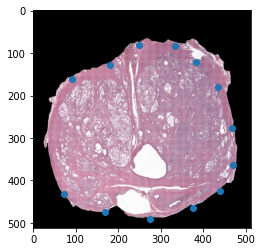

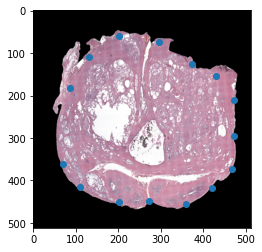

skipping slide 397
skipping slide 398
skipping slide 399


In [177]:
SCALE = 0.15
for i in range(len(all_slides)):
    current_slide = all_slides[i]
    if os.path.exists(os.path.join(current_slide, "small_recon_8_pgt_sharp.tiff")) and os.path.exists(os.path.join(current_slide, "fixed_histmri_controlPoints.csv")): 
        all_points = pd.read_csv(os.path.join(current_slide, "fixed_histmri_controlPoints.csv"), header=None).to_numpy()
        points = np.flip(all_points[:, :2], axis=-1).astype(int)
        edge_indices = get_edge_points(points)
        points = points[edge_indices]
        plt.imshow(plt.imread(os.path.join(current_slide, "small_recon_8_pgt_sharp.tiff")))
        plt.scatter(points[:, 1], points[:, 0])
        plt.show()
        all_points = all_points[edge_indices]
        np.savetxt(os.path.join(current_slide, "edge_histmri_controlPoints.csv"), all_points, delimiter=",", fmt='%f')
    else:
        print("skipping slide", i)


In [78]:
np.savetxt(os.path.join(current_slide, "edge_histmri_controlPoints.csv"), all_points, delimiter=",", fmt='%f')
print("saved", i)
i += 1

saved 0


In [716]:
print(i)

299
